In [ ]:
# -*- coding: utf-8 -*-
# Install required packages
!pip install pytorch_msssim
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
!pip install scikit-image


Looking in indexes: https://download.pytorch.org/whl/cu121


In [ ]:
import torch
import torch.nn as nn
from torch.cuda.amp import autocast
import torchvision
from torchvision import transforms
import numpy as np
import cv2
from PIL import Image
import os
from base64 import b64encode
from IPython.display import HTML, display
import time
from google.colab import drive

In [ ]:
# -------------------------
# Mount Google Drive
# -------------------------
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# -------------------------
# Device setup
# -------------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


In [ ]:
# -------------------------
# Model Definitions
# -------------------------
class MultiScaleEncoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.branch3x3 = nn.Sequential(
            nn.Conv2d(3, 126, kernel_size=3, padding=1, groups=3),
            nn.Conv2d(126, 126, kernel_size=1),
            nn.BatchNorm2d(126),
            nn.ReLU(inplace=True),
            nn.Conv2d(126, 126, kernel_size=3, padding=1),
            nn.BatchNorm2d(126),
            nn.ReLU(inplace=True)
        )
        self.branch5x5 = nn.Sequential(
            nn.Conv2d(3, 126, kernel_size=5, padding=2, groups=3),
            nn.Conv2d(126, 126, kernel_size=1),
            nn.BatchNorm2d(126),
            nn.ReLU(inplace=True),
            nn.Conv2d(126, 126, kernel_size=5, padding=2),
            nn.BatchNorm2d(126),
            nn.ReLU(inplace=True)
        )
        self.residual = nn.Conv2d(3, 252, kernel_size=1)

    def forward(self, x):
        f1 = self.branch3x3(x)
        f2 = self.branch5x5(x)
        res = self.residual(x)
        return torch.cat([f1, f2], dim=1) + res

class NoiseGateModule(nn.Module):
    def __init__(self, in_channels=252):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, 1, kernel_size=1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        mask = self.conv(x)
        mask = self.sigmoid(mask)
        return x * mask

class ChannelAttentionBlock(nn.Module):
    def __init__(self, in_channels=252):
        super().__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.conv = nn.Conv2d(in_channels * 2, in_channels, kernel_size=1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.avg_pool(x)
        max_out = self.max_pool(x)
        pooled = torch.cat([avg_out, max_out], dim=1)
        attn = self.conv(pooled)
        attn = self.sigmoid(attn)
        return x * attn

class DualHeadDecoder(nn.Module):
    def __init__(self, in_channels=252):
        super().__init__()
        self.structural_head = nn.Sequential(
            nn.Conv2d(in_channels, 126, kernel_size=3, padding=1),
            nn.BatchNorm2d(126),
            nn.ReLU(inplace=True),
            nn.Conv2d(126, 63, kernel_size=3, padding=1),
            nn.BatchNorm2d(63),
            nn.ReLU(inplace=True),
            nn.Conv2d(63, 33, kernel_size=3, padding=1),
            nn.BatchNorm2d(33),
            nn.ReLU(inplace=True),
            nn.Conv2d(33, 15, kernel_size=3, padding=1),
            nn.BatchNorm2d(15),
            nn.ReLU(inplace=True),
            nn.Conv2d(15, 3, kernel_size=3, padding=1),
            nn.BatchNorm2d(3)
        )
        self.texture_head = nn.Sequential(
            nn.Conv2d(in_channels, 126, kernel_size=5, padding=2),
            nn.BatchNorm2d(126),
            nn.ReLU(inplace=True),
            nn.Conv2d(126, 63, kernel_size=5, padding=2),
            nn.BatchNorm2d(63),
            nn.ReLU(inplace=True),
            nn.Conv2d(63, 33, kernel_size=5, padding=2),
            nn.BatchNorm2d(33),
            nn.ReLU(inplace=True),
            nn.Conv2d(33, 15, kernel_size=5, padding=2),
            nn.BatchNorm2d(15),
            nn.ReLU(inplace=True),
            nn.Conv2d(15, 3, kernel_size=5, padding=2),
            nn.BatchNorm2d(3)
        )
        self.alpha = nn.Parameter(torch.tensor(0.6))

    def forward(self, x):
        struct = self.structural_head(x)
        text = self.texture_head(x)
        return self.alpha * struct + (1 - self.alpha) * text

class SharpeningModule(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv = nn.Conv2d(3, 3, kernel_size=3, padding=1, bias=False)
        laplacian = torch.tensor([[[[0, -1, 0], [-1, 4, -1], [0, -1, 0]]]], dtype=torch.float32)
        laplacian = laplacian.repeat(3, 3, 1, 1)
        self.conv.weight = nn.Parameter(laplacian)
        self.strength = nn.Parameter(torch.tensor(0.7))

    def forward(self, x):
        edges = self.conv(x)
        return x + self.strength * edges

class BiMSAAE(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = MultiScaleEncoder()
        self.noise_gate = NoiseGateModule()
        self.attention = ChannelAttentionBlock()
        self.decoder = DualHeadDecoder()
        self.sharpen = SharpeningModule()
        self.skip_conv = nn.Conv2d(252, 252, kernel_size=1)

    def forward(self, x):
        f = self.encoder(x)
        skip = self.skip_conv(f)
        f = self.noise_gate(f)
        f = self.attention(f)
        f = f + skip
        out = self.decoder(f)
        out = torch.sigmoid(out)
        out = self.sharpen(out)
        return torch.clamp(out, 0, 1)


In [ ]:
# -------------------------
# Load trained model
# -------------------------
model_path = '/content/drive/MyDrive/bimsaae_newcheckpoints/bimsaae_final.pth'
model = BiMSAAE().to(device)
checkpoint = torch.load(model_path, map_location=device)
model.load_state_dict(checkpoint)
model.eval()
print(f"Model loaded from {model_path}")

Model loaded from /content/drive/MyDrive/bimsaae_newcheckpoints/bimsaae_final.pth


In [ ]:
# -------------------------
# Video paths
# -------------------------
input_clean_video_path = '/content/drive/MyDrive/cleanvideo.mp4'
noisy_video_path = '/content/drive/MyDrive/RGBnoisyvideo.mp4'
denoised_video_path = '/content/drive/MyDrive/RGBdenoisedvideo.mp4'

# Ensure output folder exists
os.makedirs(os.path.dirname(noisy_video_path), exist_ok=True)
os.makedirs(os.path.dirname(denoised_video_path), exist_ok=True)

In [ ]:
# -------------------------
# Install required packages
# -------------------------
!pip install moviepy
!pip install pytorch_msssim

# -------------------------
# Imports
# -------------------------
import torch
import torch.nn as nn
from torch.cuda.amp import autocast
from torchvision import transforms
import numpy as np
import cv2
from PIL import Image
from base64 import b64encode
from IPython.display import HTML, display
from moviepy.editor import ImageSequenceClip
import os

# -------------------------
# Video and model paths
# -------------------------
input_clean_video_path = '/content/drive/MyDrive/cleanvideo.mp4'
noisy_video_path = '/content/drive/MyDrive/RGBnoisyvideo.mp4'
denoised_video_path = '/content/drive/MyDrive/RGBdenoisedvideo.mp4'

# -------------------------
# Device and model
# -------------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.eval()  # make sure model is loaded already

# -------------------------
# Video processing parameters
# -------------------------
sigma = 15  # Gaussian noise std
resize_to_model = True
model_size = (256, 256)
resize_transform = transforms.Resize(model_size)

# -------------------------
# Read video
# -------------------------
cap = cv2.VideoCapture(input_clean_video_path)
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

resize_back_transform = transforms.Resize((height, width))

# Store frames
noisy_frames_list = []
denoised_frames_list = []

total_frames = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # BGR -> RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Add Gaussian noise
    noise = np.random.normal(0, sigma, frame_rgb.shape).astype(np.float32)
    noisy_frame = np.clip(frame_rgb.astype(np.float32) + noise, 0, 255).astype(np.uint8)
    noisy_frames_list.append(noisy_frame)

    # Prepare tensor for model
    noisy_pil = Image.fromarray(noisy_frame)
    if resize_to_model:
        noisy_pil = resize_transform(noisy_pil)
    noisy_tensor = transforms.ToTensor()(noisy_pil).unsqueeze(0).to(device)

    # Denoise
    with torch.no_grad(), autocast():
        denoised_tensor = model(noisy_tensor)

    # Convert to uint8 and resize back
    denoised_frame = (denoised_tensor.squeeze(0).cpu().permute(1,2,0).numpy() * 255).astype(np.uint8)
    if resize_to_model:
        denoised_frame = cv2.resize(denoised_frame, (width, height))
    denoised_frames_list.append(denoised_frame)

    total_frames += 1

cap.release()
print(f"Processed {total_frames} frames successfully!")

# -------------------------
# Save videos with moviepy
# -------------------------
ImageSequenceClip(noisy_frames_list, fps=fps).write_videofile(noisy_video_path, codec='libx264')
ImageSequenceClip(denoised_frames_list, fps=fps).write_videofile(denoised_video_path, codec='libx264')

# -------------------------
# Display videos in Colab
# -------------------------
def embed_video(path, title):
    with open(path, 'rb') as f:
        video_data = b64encode(f.read()).decode()
    return f"""
    <div style="text-align:center;">
        <h3>{title}</h3>
        <video width="320" height="240" controls>
            <source src="data:video/mp4;base64,{video_data}" type="video/mp4">
        </video>
    </div>
    """

html_content = f"""
<div style="display:flex; justify-content:space-around; align-items:flex-start;">
    {embed_video(input_clean_video_path, "Clean Video")}
    {embed_video(noisy_video_path, "Noisy Video")}
    {embed_video(denoised_video_path, "Denoised Video")}
</div>
"""
display(HTML(html_content))

/usr/local/lib/python3.12/dist-packages/moviepy/config_defaults.py:47: SyntaxWarning: invalid escape sequence '\P'
  IMAGEMAGICK_BINARY = r"C:\Program Files\ImageMagick-6.8.8-Q16\magick.exe"
/usr/local/lib/python3.12/dist-packages/moviepy/video/io/ffmpeg_reader.py:294: SyntaxWarning: invalid escape sequence '\d'
  lines_video = [l for l in lines if ' Video: ' in l and re.search('\d+x\d+', l)]
/usr/local/lib/python3.12/dist-packages/moviepy/video/io/ffmpeg_reader.py:367: SyntaxWarning: invalid escape sequence '\d'
  rotation_lines = [l for l in lines if 'rotate          :' in l and re.search('\d+$', l)]
/usr/local/lib/python3.12/dist-packages/moviepy/video/io/ffmpeg_reader.py:370: SyntaxWarning: invalid escape sequence '\d'
  match = re.search('\d+$', rotation_line)
  if event.key is 'enter':

  with torch.no_grad(), autocast():



Processed 523 frames successfully!
Moviepy - Building video /content/drive/MyDrive/RGBnoisyvideo.mp4.
Moviepy - Writing video /content/drive/MyDrive/RGBnoisyvideo.mp4



Moviepy - Done !
Moviepy - video ready /content/drive/MyDrive/RGBnoisyvideo.mp4
Moviepy - Building video /content/drive/MyDrive/RGBdenoisedvideo.mp4.
Moviepy - Writing video /content/drive/MyDrive/RGBdenoisedvideo.mp4



Moviepy - Done !
Moviepy - video ready /content/drive/MyDrive/RGBdenoisedvideo.mp4


  with torch.no_grad(), autocast():



Processed 523 frames successfully!


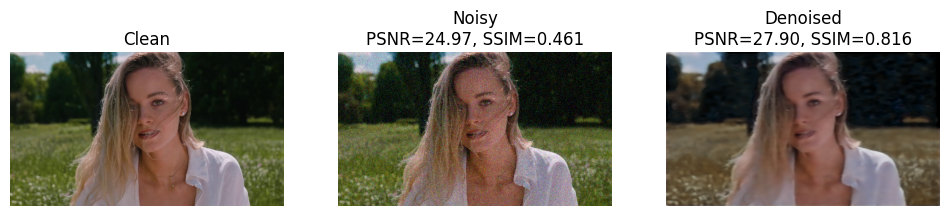

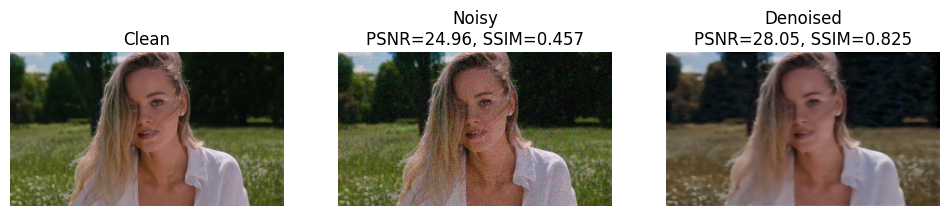

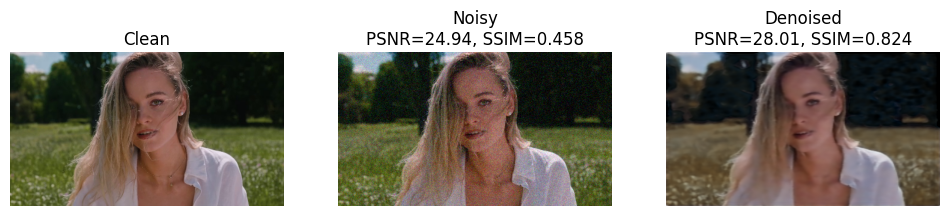

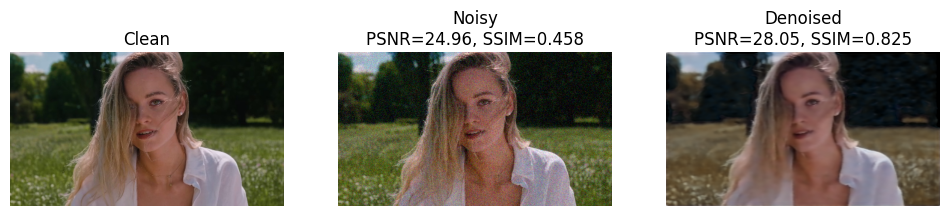

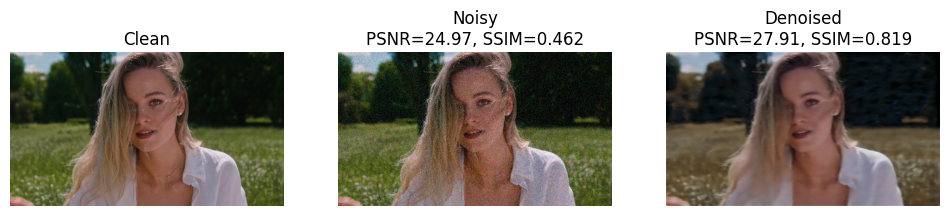

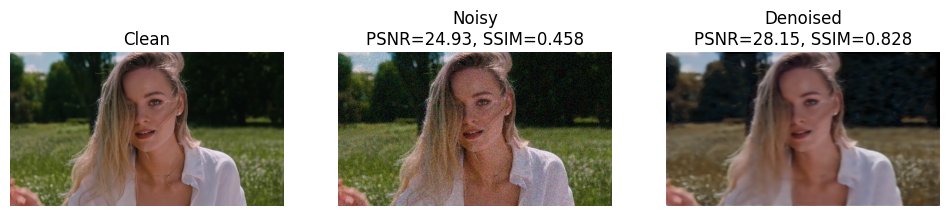

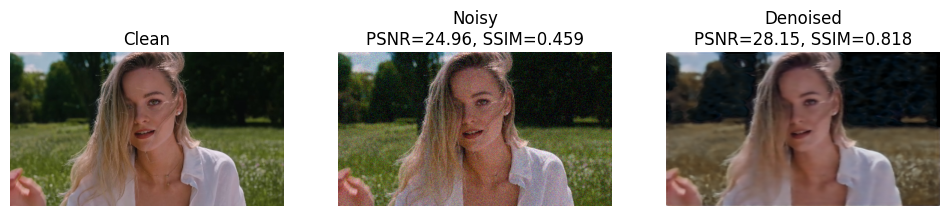

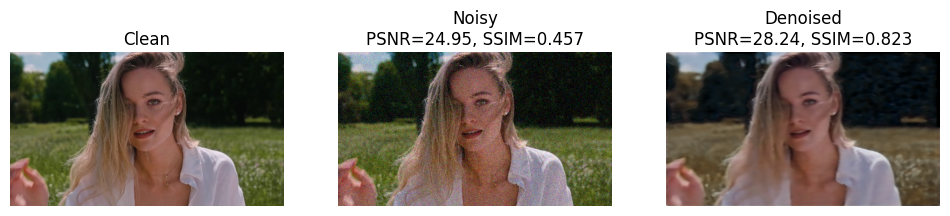

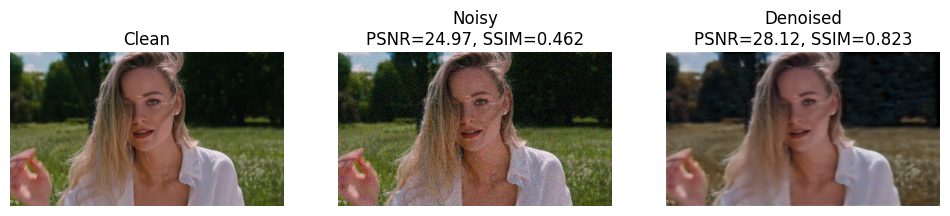

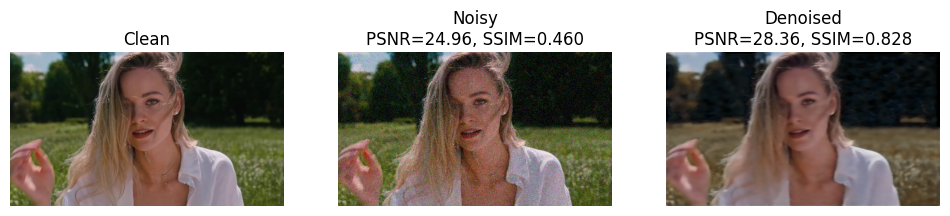

=== Aggregate Metrics ===
Average PSNR (Clean vs Noisy): 24.96
Average PSNR (Clean vs Denoised): 28.09
Average SSIM (Clean vs Noisy): 0.4592
Average SSIM (Clean vs Denoised): 0.8228


In [ ]:
# -------------------------
# Parameters
# -------------------------
sigma = 15
num_eval_frames = 10
resize_to_model = True
model_size = (256, 256)

# -------------------------
# Video processing + store frames
# -------------------------
cap = cv2.VideoCapture(input_clean_video_path)
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
resize_transform = transforms.Resize(model_size)
resize_back_transform = transforms.Resize((height, width))

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out_noisy = cv2.VideoWriter(noisy_video_path, fourcc, fps, (width, height))
out_denoised = cv2.VideoWriter(denoised_video_path, fourcc, fps, (width, height))

if not out_noisy.isOpened() or not out_denoised.isOpened():
    raise RuntimeError("Failed to open VideoWriter. Check codec or path.")

total_frames = 0
clean_frames_list = []
noisy_frames_list = []
denoised_frames_list = []

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    # Store first N frames for evaluation
    if total_frames < num_eval_frames:
        clean_frames_list.append(frame_rgb.copy())

    # Add Gaussian noise
    noise = np.random.normal(0, sigma, frame_rgb.shape).astype(np.float32)
    noisy_frame = np.clip(frame_rgb.astype(np.float32) + noise, 0, 255).astype(np.uint8)
    out_noisy.write(cv2.cvtColor(noisy_frame, cv2.COLOR_RGB2BGR))
    if total_frames < num_eval_frames:
        noisy_frames_list.append(noisy_frame.copy())

    # Prepare tensor
    noisy_pil = Image.fromarray(noisy_frame)
    if resize_to_model:
        noisy_pil = resize_transform(noisy_pil)
    noisy_tensor = transforms.ToTensor()(noisy_pil).unsqueeze(0).to(device)

    # Denoise
    with torch.no_grad(), autocast():
        denoised_tensor = model(noisy_tensor)

    # Resize back and convert
    denoised_frame = (denoised_tensor.squeeze(0).cpu().permute(1, 2, 0).numpy() * 255).astype(np.uint8)
    if resize_to_model:
        denoised_frame = cv2.resize(denoised_frame, (width, height))
    out_denoised.write(cv2.cvtColor(denoised_frame, cv2.COLOR_RGB2BGR))

    if total_frames < num_eval_frames:
        denoised_frames_list.append(denoised_frame.copy())

    total_frames += 1

cap.release()
out_noisy.release()
out_denoised.release()
print(f"Processed {total_frames} frames successfully!")

# -------------------------
# Evaluation: PSNR + SSIM
# -------------------------
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt
import numpy as np

psnr_noisy_list, psnr_denoised_list = [], []
ssim_noisy_list, ssim_denoised_list = [], []

for i in range(num_eval_frames):
    clean = clean_frames_list[i]
    noisy = noisy_frames_list[i]
    denoised = denoised_frames_list[i]

    # Metrics
    psnr_noisy_val = psnr(clean, noisy, data_range=255)
    psnr_denoised_val = psnr(clean, denoised, data_range=255)
    ssim_noisy_val = ssim(clean, noisy, channel_axis=-1, data_range=255)
    ssim_denoised_val = ssim(clean, denoised, channel_axis=-1, data_range=255)

    psnr_noisy_list.append(psnr_noisy_val)
    psnr_denoised_list.append(psnr_denoised_val)
    ssim_noisy_list.append(ssim_noisy_val)
    ssim_denoised_list.append(ssim_denoised_val)

    # Display frames
    fig, axes = plt.subplots(1,3, figsize=(12,4))
    axes[0].imshow(clean)
    axes[0].set_title("Clean")
    axes[0].axis('off')
    axes[1].imshow(noisy)
    axes[1].set_title(f"Noisy\nPSNR={psnr_noisy_val:.2f}, SSIM={ssim_noisy_val:.3f}")
    axes[1].axis('off')
    axes[2].imshow(denoised)
    axes[2].set_title(f"Denoised\nPSNR={psnr_denoised_val:.2f}, SSIM={ssim_denoised_val:.3f}")
    axes[2].axis('off')
    plt.show()

# Aggregate metrics
print("=== Aggregate Metrics ===")
print(f"Average PSNR (Clean vs Noisy): {np.mean(psnr_noisy_list):.2f}")
print(f"Average PSNR (Clean vs Denoised): {np.mean(psnr_denoised_list):.2f}")
print(f"Average SSIM (Clean vs Noisy): {np.mean(ssim_noisy_list):.4f}")
print(f"Average SSIM (Clean vs Denoised): {np.mean(ssim_denoised_list):.4f}")

📊 PSNR bar graph saved: /content/drive/MyDrive/video_evaluation_graphs/video_psnr_comparison_10_frames.png
📈 Displaying PSNR graph:


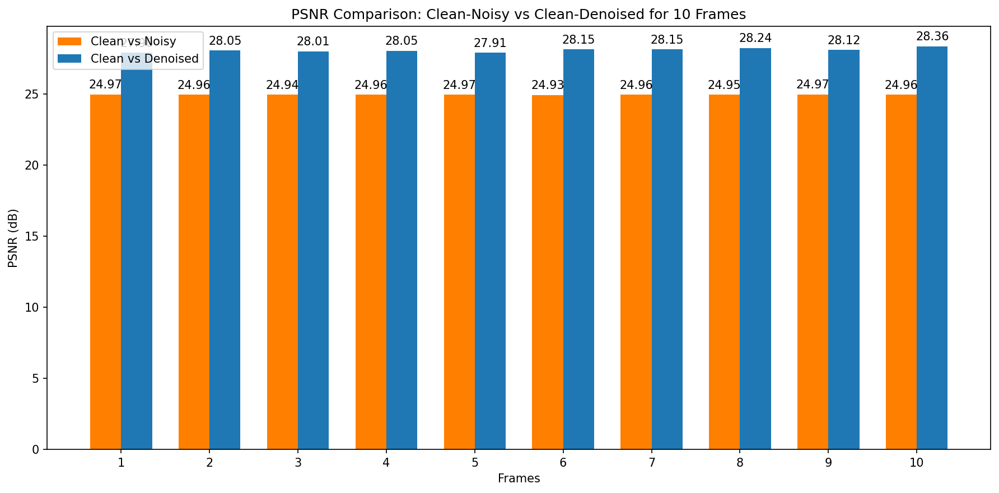

📈 Displaying SSIM graph:


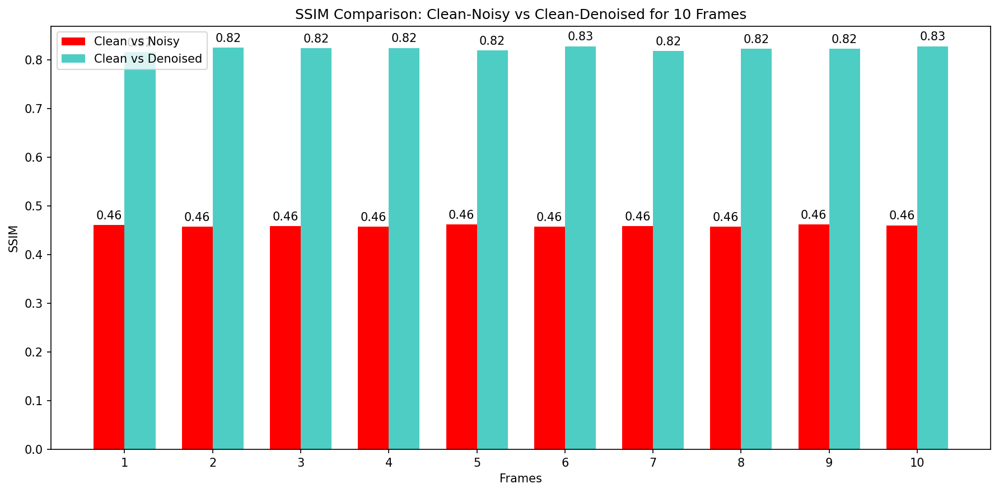

In [ ]:
import os
import matplotlib.pyplot as plt
from IPython.display import Image, display

# Make sure output directory exists
output_dir = '/content/drive/MyDrive/video_evaluation_graphs'
os.makedirs(output_dir, exist_ok=True)

# Use the metric lists from previous evaluation
# psnr_noisy_list, psnr_denoised_list, ssim_noisy_list, ssim_denoised_list

num_samples = len(psnr_noisy_list)  # Should be 10
samples = [str(i+1) for i in range(num_samples)]
x = np.arange(len(samples))
width = 0.35

# -------------------------
# PSNR Grouped Bar Graph
# -------------------------
fig, ax = plt.subplots(figsize=(12, 6))
bars1 = ax.bar(x - width/2, psnr_noisy_list, width, label='Clean vs Noisy', color='#FF7F00')
bars2 = ax.bar(x + width/2, psnr_denoised_list, width, label='Clean vs Denoised', color='#1f77b4')

ax.set_xlabel('Frames')
ax.set_ylabel('PSNR (dB)')
ax.set_title('PSNR Comparison: Clean-Noisy vs Clean-Denoised for 10 Frames')
ax.set_xticks(x)
ax.set_xticklabels(samples)
ax.legend()

# Add value labels
def autolabel(bars):
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.2f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(bars1)
autolabel(bars2)

plt.tight_layout()
psnr_graph_path = os.path.join(output_dir, 'video_psnr_comparison_10_frames.png')
plt.savefig(psnr_graph_path, dpi=150, bbox_inches='tight')
plt.close(fig)
print(f"📊 PSNR bar graph saved: {psnr_graph_path}")

# -------------------------
# SSIM Grouped Bar Graph
# -------------------------
fig, ax = plt.subplots(figsize=(12, 6))
bars1 = ax.bar(x - width/2, ssim_noisy_list, width, label='Clean vs Noisy', color='#FF0000')
bars2 = ax.bar(x + width/2, ssim_denoised_list, width, label='Clean vs Denoised', color='#4ECDC4')

ax.set_xlabel('Frames')
ax.set_ylabel('SSIM')
ax.set_title('SSIM Comparison: Clean-Noisy vs Clean-Denoised for 10 Frames')
ax.set_xticks(x)
ax.set_xticklabels(samples)
ax.legend()

autolabel(bars1)
autolabel(bars2)

plt.tight_layout()
ssim_graph_path = os.path.join(output_dir, 'video_ssim_comparison_10_frames.png')
plt.savefig(ssim_graph_path, dpi=150, bbox_inches='tight')
plt.close(fig)

# Display the graphs in Colab
print("📈 Displaying PSNR graph:")
display(Image(filename=psnr_graph_path))

print("📈 Displaying SSIM graph:")
display(Image(filename=ssim_graph_path))